In [ ]:
gpu_info = !nvidia-smi
gpu_info = '\n'.join(gpu_info)
if gpu_info.find('failed') >= 0:
  print('Not connected to a GPU')
else:
  print(gpu_info)

Tue Dec 27 04:01:06 2022       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 460.32.03    Driver Version: 460.32.03    CUDA Version: 11.2     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  A100-SXM4-40GB      Off  | 00000000:00:04.0 Off |                    0 |
| N/A   36C    P0    53W / 400W |      0MiB / 40536MiB |      0%      Default |
|                               |                      |             Disabled |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

In [ ]:
import torch

# setting device on GPU if available, else CPU
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
print('Using device:', device)
print()

#Additional Info when using cuda
if device.type == 'cuda':
    print(torch.cuda.get_device_name(0))
    print('Memory Usage:')
    print('Allocated:', round(torch.cuda.memory_allocated(0)/1024**3,1), 'GB')
    print('Cached:   ', round(torch.cuda.memory_reserved(0)/1024**3,1), 'GB')

Using device: cuda

A100-SXM4-40GB
Memory Usage:
Allocated: 0.0 GB
Cached:    0.0 GB


In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


> # 🔶 **Pre-Settings:**


In [ ]:
#### --------- Settings --------
load_losses1 = False
load_losses2 = True
load_losses3 = False


load_model1 = True
load_model2 = True
load_model3 = False


load_epoch1 = 105
load_epoch2 = 42
load_epoch3 = 105

checkpoint_path_loss = '/content/drive/Shareddrives/AI/Models/Checkpoints/MyVideoModel_Final_Residual_V3_BN/'
checkpoint_path_model = '/content/drive/Shareddrives/AI/Models/Checkpoints/MyVideoModel_Final_Residual_V3_BN/'


checkpoint_path_loss2 = '/content/drive/MyDrive/Models/Checkpoints/MyVideoModel_Final_Residual_V3_BN_Diff/'
checkpoint_path_model2 = '/content/drive/MyDrive/Models/Checkpoints/MyVideoModel_Final_Residual_V3_BN_Diff/'
# ------------------------------
lr= 0.0002 # Learning rate

In [ ]:
from psutil import virtual_memory
ram_gb = virtual_memory().total / 1e9
print('Your runtime has {:.1f} gigabytes of available RAM\n'.format(ram_gb))

if ram_gb < 20:
  print('Not using a high-RAM runtime')
else:
  print('You are using a high-RAM runtime!')

Your runtime has 89.6 gigabytes of available RAM

You are using a high-RAM runtime!


In [ ]:
import torch

# setting device on GPU if available, else CPU
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
print('Using device:', device)
print()

#Additional Info when using cuda
if device.type == 'cuda':
    print(torch.cuda.get_device_name(0))
    print('Memory Usage:')
    print('Allocated:', round(torch.cuda.memory_allocated(0)/1024**3,1), 'GB')
    print('Cached:   ', round(torch.cuda.memory_reserved(0)/1024**3,1), 'GB')


Using device: cuda

A100-SXM4-40GB
Memory Usage:
Allocated: 0.0 GB
Cached:    0.0 GB


> # 🔶 **Download & Un-Zip Datasets:**

In [ ]:
# !pip install --upgrade --no-cache-dir gdown

In [ ]:
# !unzip RawFrames_360p_6Frames_CRF0_PNG_RGB.zip -d '/content/'
!unzip -u '/content/drive/Shareddrives/AI/Datasets/ExtractedFrames/Nature_Frames2/RawFrames_240p_6Frames_CRF13_PNG_RGB_Slow.zip' -d '/content/'

# '/content/drive/MyDrive/AI/Datasets/ExtractedFrames/Nature_Frames2/RawFrames_240p_6Frames_CRF13_PNG_RGB_Slow.zip'

Streaming output truncated to the last 5000 lines.
  inflating: /content/Frames/RawFrames/Train/rawframe11583.png  
  inflating: /content/Frames/RawFrames/Train/rawframe14495.png  
  inflating: /content/Frames/RawFrames/Train/rawframe34294.png  
  inflating: /content/Frames/RawFrames/Train/rawframe03762.png  
  inflating: /content/Frames/RawFrames/Train/rawframe34565.png  
  inflating: /content/Frames/RawFrames/Train/rawframe37403.png  
  inflating: /content/Frames/RawFrames/Train/rawframe14961.png  
  inflating: /content/Frames/RawFrames/Train/rawframe00560.png  
  inflating: /content/Frames/RawFrames/Train/rawframe33460.png  
  inflating: /content/Frames/RawFrames/Train/rawframe09512.png  
  inflating: /content/Frames/RawFrames/Train/rawframe14105.png  
  inflating: /content/Frames/RawFrames/Train/rawframe13538.png  
  inflating: /content/Frames/RawFrames/Train/rawframe20503.png  
  inflating: /content/Frames/RawFrames/Train/rawframe38890.png  
  inflating: /content/Frames/RawFrames/

In [ ]:
# Download Decoded Frames (CRF40):
# !gdown 1-EFXCAaVuA-grCf__SmMugxyoUigVYur
# !unzip -u '/content/drive/MyDrive/AI/Datasets/ExtractedFrames/Nature_Frames2/ResidualFrames_240p_6Frames_CRF13_40_PNG_RGB_NoNorm.zip' -d '/content/'

In [ ]:
# !unzip CompressedFrames_360p_6Frames_CRF33_PNG_RGB.zip -d '/content/'

!unzip -u '/content/drive/Shareddrives/AI/Datasets/ExtractedFrames/Nature_Frames2/CompressedFrames_240p_6Frames_CRF40_PNG_RGB.zip' -d '/content/'

# '/content/drive/MyDrive/AI/Datasets/ExtractedFrames/Nature_Frames2/CompressedFrames_240p_6Frames_CRF40_PNG_RGB.zip'

Streaming output truncated to the last 5000 lines.
  inflating: /content/Frames/CompressedFrames_CRF40/Train/compframe25368.png  
  inflating: /content/Frames/CompressedFrames_CRF40/Train/compframe02350.png  
  inflating: /content/Frames/CompressedFrames_CRF40/Train/compframe21820.png  
  inflating: /content/Frames/CompressedFrames_CRF40/Train/compframe29630.png  
  inflating: /content/Frames/CompressedFrames_CRF40/Train/compframe36412.png  
  inflating: /content/Frames/CompressedFrames_CRF40/Train/compframe35700.png  
  inflating: /content/Frames/CompressedFrames_CRF40/Train/compframe33976.png  
  inflating: /content/Frames/CompressedFrames_CRF40/Train/compframe39918.png  
  inflating: /content/Frames/CompressedFrames_CRF40/Train/compframe25584.png  
  inflating: /content/Frames/CompressedFrames_CRF40/Train/compframe39545.png  
  inflating: /content/Frames/CompressedFrames_CRF40/Train/compframe30937.png  
  inflating: /content/Frames/CompressedFrames_CRF40/Train/compframe04139.png  
 

In [ ]:
!git clone https://github.com/parhamzm/Video-Compression-Tools.git

!cp '/content/Video-Compression-Tools/image_utils.py' './'

from image_utils import plot_images, normalize_image

!ls

Cloning into 'Video-Compression-Tools'...
remote: Enumerating objects: 24, done.
remote: Counting objects: 100% (24/24), done.
remote: Compressing objects: 100% (23/23), done.
remote: Total 24 (delta 10), reused 0 (delta 0), pack-reused 0
Unpacking objects: 100% (24/24), done.
drive	image_utils.py	sample_data
Frames	__pycache__	Video-Compression-Tools


# **Code:**

In [ ]:
# %reload_ext autoreload
# %autoreload 2
%matplotlib inline

import math
import time
import os
import glob
import json
import ast
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from tqdm.auto import tqdm
from PIL import Image
from sklearn.metrics import confusion_matrix
from sklearn.model_selection import train_test_split
from torch.utils.data import Dataset, DataLoader, random_split


import torch
import torch.nn as nn
import torch.optim as optim
from torch.autograd import Variable

import torchvision
import torchvision.datasets as datasets
import torchvision.models as models
import torchvision.transforms as transforms

from torchvision.datasets import ImageFolder, DatasetFolder

from google.colab import files

# Our libraries

# some initial setup
# np.set_printoptions(precision=2)
use_gpu = torch.cuda.is_available()
# np.random.seed(1234)
device = torch.device("cuda") if torch.cuda.is_available() else torch.device("cpu")

In [ ]:
Train_decoded_DATA_DIR = '/content/Frames/CompressedFrames_CRF40/Train/'
Train_residual_DATA_DIR = '/content/Frames/ResidualFrames/Train/'
Train_raw_DATA_DIR = '/content/Frames/RawFrames/Train/'

Test_decoded_DATA_DIR = '/content/Frames/CompressedFrames_CRF40/Test/'
Test_residual_DATA_DIR = '/content/Frames/ResidualFrames/Test/'
Test_raw_DATA_DIR = '/content/Frames/RawFrames/Test/'

In [ ]:
import os
from skimage import io
import pandas as pd
from torchvision.io import read_image



class MyDataset(Dataset):
    def __init__(self, datasetA_dir, datasetB_dir, transform=None):
        self.datasetA_dir = datasetA_dir
        self.datasetB_dir = datasetB_dir
        self.transform = transform
        
    def __getitem__(self, index):
        # print("index: ", index)
        # print("dirA: ", self.datasetA_dir)
        # print("dirB: ", self.datasetB_dir)
        # print("LenA: ", len(self.datasetA_dir))
        # print("LenB: ", len(self.datasetB_dir))
        digA = "compframe" + ("0" * (5 - len(str(index)))) + str(index) + ".png"
        dirA = os.path.join(self.datasetA_dir, digA)
        digB = "rawframe" + ("0" * (5 - len(str(index)))) + str(index) + ".png"
        dirB = os.path.join(self.datasetB_dir, digB)
        # xA = self.datasetA_dir[index]
        # xB = self.datasetB_dir[index]
        imageA = io.imread(dirA)
        imageB = io.imread(dirB)
        if self.transform:
            imageA = self.transform(imageA)
            imageB = self.transform(imageB)
        res = {'RawIMG': imageB, 'RawName': digB, 'CompIMG': imageA, 'CompName': digA}
        # return imageA, imageB
        return res
    
    def __len__(self):
        path, dirs, filesA = next(os.walk(self.datasetA_dir))
        # path, dirs, filesB = next(os.walk(self.datasetB_dir))
        file_countA = len(filesA)
        # file_countB = len(filesB)
        # print("File CountA: ", file_countA)
        # print("File CountB: ", file_countB)
        # print("Len Decoded:", len(self.datasetA_dir))
        # print("Len Raw:", len(self.datasetB_dir))
        return file_countA


transform_train = transforms.Compose([
    transforms.ToPILImage(),
    transforms.RandomHorizontalFlip(),
    transforms.RandomRotation(3),
    transforms.RandomAffine(0, shear=10, scale=(0.8, 1.2)),
    transforms.ColorJitter(brightness=0.2, contrast=0.2, saturation=0.2),
    transforms.RandomApply([
      transforms.ColorJitter(0.4, 0.4, 0.4, 0.1)], p=0.8
    ),
    transforms.RandomGrayscale(0.2),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.4914, 0.4822, 0.4465], std=[0.2023, 0.1994, 0.2010]),
])

train_dataset = MyDataset(Train_decoded_DATA_DIR, Train_raw_DATA_DIR, transform=transforms.Compose([
                                transforms.ToTensor(),
                              #   torchvision.transforms.Normalize(
                              #     mean=[0.5, 0.5, 0.5],
                              #     std=[0.5, 0.5, 0.5],
                              # ),
                            ])
)

test_dataset = MyDataset(Test_decoded_DATA_DIR, Test_raw_DATA_DIR, transform=transforms.Compose([
                                transforms.ToTensor(),
                              #   torchvision.transforms.Normalize(
                              #     mean=[0.5, 0.5, 0.5],
                              #     std=[0.5, 0.5, 0.5],
                              # ),
                            ])
)

#   torchvision.transforms.Normalize(
                              #     mean=[0.485, 0.456, 0.406],
                              #     std=[0.229, 0.224, 0.225],
                              # ),

In [ ]:
train_loader = torch.utils.data.DataLoader(train_dataset, batch_size=16, shuffle=True, num_workers=2)
test_loader = torch.utils.data.DataLoader(test_dataset, batch_size=16, shuffle=True)

# print(len(train_dataset.))
# print(len(train_raw_dataset.samples))
# print(len(test_decoded_dataset.samples))
# print(len(test_raw_dataset.samples))
# print(len(train_raw_dataset))
# print(len(train_decoded_dataset))
print(len(train_dataset))

41400


In [ ]:
# my_mse = nn.MSELoss()
# my_mae = nn.L1Loss()

# no_dae_loss = []
# for noise_batch, image_batch in tqdm(train_loader): #zip(train_decoded_loader, train_raw_loader):
#     loss1 = my_mae(noise_batch.to(device), image_batch.to(device))
#     # loss2 = my_mae(noise_batch, image_batch)
#     loss =  loss1
#     no_dae_loss.append(loss.item())
# print("Train Loss without DAE:=> {:.20f}".format(np.mean(no_dae_loss)))


# no_dae_loss = []
# for noise_batch, image_batch in tqdm(test_loader): #zip(test_decoded_loader, test_raw_loader):
#     loss1 = my_mae(noise_batch.to(device), image_batch.to(device))
#     # loss2 = my_mae(noise_batch, image_batch)
#     loss = loss1
#     no_dae_loss.append(loss.item())
# print("Test Loss without DAE:=> {:.20f}".format(np.mean(no_dae_loss)))

# # Train Loss without DAE:=> 0.02978461904001336591
# # Test Loss without DAE:=> 0.03176539410450028578

In [ ]:
# batch1, batch2 = next(iter(train_loader))

# train_data = batch1
# train_data2 = batch2

# classes = np.zeros(len(train_data)+1, dtype='int32') #0 #train_data.classes

# # plot_images(batch1, classes, classes)

In [ ]:
# plot_images(batch2, classes, classes)

# **U-Net Class:**

In [ ]:
def weights_init_normal(m):
    classname = m.__class__.__name__
    if classname.find("Conv") != -1:
        # torch.nn.init.normal_(m.weight.data, 0.0, 0.02)
        # torch.nn.init.uniform_(m.weight.data, 0., 0.002)
        # torch.nn.init.kaiming_uniform_(m.weight, nonlinearity='relu')
        torch.nn.init.kaiming_normal_(m.weight.data, nonlinearity='leaky_relu', mode='fan_in')
    elif classname.find("BatchNorm2d") != -1:
        # torch.nn.init.normal_(m.weight.data, 1.0, 0.02)
        # torch.nn.init.uniform_(m.weight.data, 0., 0.002)
        # torch.nn.init.kaiming_uniform_(m.weight, nonlinearity='relu')
        torch.nn.init.kaiming_normal_(m.weight.data, nonlinearity='leaky_relu', mode='fan_in')
        # torch.nn.init.constant_(m.bias.data, 0.0)


def initialize_weights(m):
  if isinstance(m, nn.Conv2d):
      nn.init.kaiming_uniform_(m.weight.data, nonlinearity='leaky_relu')
      # torch.nn.init.xavier_uniform_(m.weight.data, gain=1.0)
      # torch.nn.init.uniform_(m.weight.data, 0., 0.02)
      if m.bias is not None:
          nn.init.constant_(m.bias.data, 0)
  elif isinstance(m, nn.BatchNorm2d):
      nn.init.constant_(m.weight.data, 1)
      nn.init.constant_(m.bias.data, 0)
  elif isinstance(m, nn.Linear):
      nn.init.kaiming_uniform_(m.weight.data, nonlinearity='leaky_relu')
      # torch.nn.init.xavier_uniform_(m.weight.data, gain=1.0)
      # torch.nn.init.uniform_(m.weight.data, 0., 0.02)
      nn.init.constant_(m.bias.data, 0)

In [ ]:
#########################################
#           U-NET -             #
#########################################
def crop(image, new_shape):
    '''
    Function for cropping an image tensor: Given an image tensor and the new shape,
    crops to the center pixels (assumes that the input's size and the new size are
    even numbers).
    Parameters:
        image: image tensor of shape (batch size, channels, height, width)
        new_shape: a torch.Size object with the shape you want x to have
    '''
    # There are many ways to implement this crop function, but it's what allows
    # the skip connection to function as intended with two differently sized images!
    #### START CODE HERE ####
    middle_height = image.shape[2] // 2
    middle_width = image.shape[3] // 2
    starting_height = middle_height - round(new_shape[2] / 2)
    final_height = starting_height + new_shape[2]
    starting_width = middle_width - round(new_shape[3] / 2)
    final_width = starting_width + new_shape[3]
    cropped_image = image[:, :, starting_height:final_height, starting_width:final_width]
    return cropped_image

class ResidualBlock(nn.Module):
    '''
    ResidualBlock Class:
    Performs two convolutions and an instance normalization, the input is added
    to this output to form the residual block output.
    Values:
        input_channels: the number of channels to expect from a given input
    '''
    def conv_block(self, in_features, kernal_size, padding, use_bn=False, activation='celu'):
        activations = nn.ModuleDict([
                ['lrelu', nn.LeakyReLU(0.2, inplace=True)],
                ['relu', nn.ReLU(inplace=True)],
                ['celu', torch.nn.CELU(alpha=1.0, inplace=True)],
                ['rrelu', nn.RReLU(lower=0.125, upper=0.3333333333333333, inplace=True)],
        ])
        if use_bn:
            layers = [
              torch.nn.Conv2d(in_features, in_features, kernel_size=kernal_size, padding=padding, padding_mode='reflect'),
              nn.InstanceNorm2d(in_features),
              activations[activation],
              torch.nn.Conv2d(in_features, in_features, kernel_size=kernal_size, padding=padding, padding_mode='reflect'),
              nn.InstanceNorm2d(in_features),
            ]
        else:
            layers = [
              torch.nn.Conv2d(in_features, in_features, kernel_size=kernal_size, padding=padding, padding_mode='reflect'),
              activations[activation],
              torch.nn.Conv2d(in_features, in_features, kernel_size=kernal_size, padding=padding, padding_mode='reflect'),
            ]
        block = torch.nn.Sequential(*layers)
        return block

    def __init__(self, input_channels, k=7, p=3, use_bn=True):
        super(ResidualBlock, self).__init__()
        self.residual_layer1 = self.conv_block(in_features=input_channels, kernal_size=k, padding=p, use_bn=use_bn)

    def forward(self, x):
        '''
        Function for completing a forward pass of ResidualBlock: 
        Given an image tensor, completes a residual block and returns the transformed tensor.
        Parameters:
            x: image tensor of shape (batch size, channels, height, width)
        '''
        original_x = x.clone()
        x = self.residual_layer1(x)
        return original_x + x


# GRADED CLASS: ContractingBlock
class ContractingBlock(nn.Module):
    '''
    ContractingBlock Class
    Performs two convolutions followed by a max pool operation.
    Values:
        input_channels: the number of channels to expect from a given input
    '''
    def conv_block(self, in_features, kernal_size, padding, use_bn=False, max_pool=False, activation='lrelu'):
        activations = nn.ModuleDict([
                ['lrelu', nn.LeakyReLU(0.2, inplace=True)],
                ['relu', nn.ReLU(inplace=True)],
                ['celu', torch.nn.CELU(alpha=1.0, inplace=True)],
                ['rrelu', nn.RReLU(lower=0.125, upper=0.3333333333333333, inplace=True)],
        ])
        if use_bn:
            layers = [
              torch.nn.Conv2d(in_features, in_features * 2, kernel_size=kernal_size, padding=padding, padding_mode='zeros'),
              nn.InstanceNorm2d(in_features * 2),
              activations[activation],
              torch.nn.Conv2d(in_features * 2, in_features * 2, kernel_size=kernal_size, padding=padding, padding_mode='zeros'),
              nn.InstanceNorm2d(in_features * 2),
              activations[activation],
              torch.nn.Conv2d(in_features * 2, in_features * 2, kernel_size=kernal_size, padding=padding, padding_mode='zeros'),
              nn.InstanceNorm2d(in_features * 2),
              activations[activation],
              torch.nn.Conv2d(in_features * 2, in_features * 2, kernel_size=kernal_size, padding=padding, padding_mode='zeros'),
              nn.InstanceNorm2d(in_features * 2),
              activations[activation],
            ]
        else:
            layers = [
              torch.nn.Conv2d(in_features, in_features * 2, kernel_size=kernal_size, padding=padding, padding_mode='zeros'),
              activations[activation],
              torch.nn.Conv2d(in_features * 2, in_features * 2, kernel_size=kernal_size, padding=padding, padding_mode='zeros'),
              activations[activation],
              torch.nn.Conv2d(in_features * 2, in_features * 2, kernel_size=kernal_size, padding=padding, padding_mode='zeros'),
              activations[activation],
              torch.nn.Conv2d(in_features * 2, in_features * 2, kernel_size=kernal_size, padding=padding, padding_mode='zeros'),
              activations[activation],
            ]
        if max_pool:
            layers.append(
                nn.Conv2d(in_features * 2, in_features * 2, kernel_size=2, stride=2, padding=0, padding_mode='zeros') # k+1, p
            )
        block = torch.nn.Sequential(*layers)
        return block

    def __init__(self, input_channels, use_dropout=False, use_bn=True, use_max_pool=True, k=7, p=3):
        super(ContractingBlock, self).__init__()
        # You want to double the number of channels in the first convolution
        # and keep the same number of channels in the second.
        #### START CODE HERE ####
        self.contracting_layer1 = self.conv_block(in_features=input_channels, kernal_size=k, padding=p, use_bn=use_bn, max_pool=use_max_pool)
        # if use_dropout:
        #     self.dropout = nn.Dropout(p=0.3, inplace=True)
        #### END CODE HERE ####

    def forward(self, x):
        '''
        Function for completing a forward pass of ContractingBlock: 
        Given an image tensor, completes a contracting block and returns the transformed tensor.
        Parameters:
            x: image tensor of shape (batch size, channels, height, width)
        '''
        x = self.contracting_layer1(x)
        
        return x



# CLASS: ExpandingBlock
class ExpandingBlock(nn.Module):
    '''
    ExpandingBlock Class
    Performs an upsampling, a convolution, a concatenation of its two inputs,
    followed by two more convolutions.
    Values:
        input_channels: the number of channels to expect from a given input
    '''
    def conv_block1(self, in_features, kernal_size, padding, upsample=False):
        activations = nn.ModuleDict([
                ['lrelu', nn.LeakyReLU(0.2, inplace=True)],
                ['relu', nn.ReLU(inplace=True)],
                ['celu', torch.nn.CELU(alpha=1.0, inplace=True)],
                ['rrelu', nn.RReLU(lower=0.125, upper=0.3333333333333333, inplace=True)],
        ])
        if upsample:
            layers_part1 = [
                nn.ConvTranspose2d(in_features, in_features // 2, kernel_size=2, stride=2, padding=0) # k+1, p
            ]
        else:
            layers_part1 = [
                nn.Conv2d(in_features, in_features // 2, kernel_size=kernal_size, padding=padding, padding_mode='zeros')
            ]
            
        block1 = torch.nn.Sequential(*layers_part1)
        return block1

    def conv_block2(self, in_features, kernal_size, padding, use_bn=False, activation='celu'):
        activations = nn.ModuleDict([
                ['lrelu', nn.LeakyReLU(0.2, inplace=True)],
                ['relu', nn.ReLU(inplace=True)],
                ['celu', torch.nn.CELU(alpha=1.0, inplace=True)],
                ['rrelu', nn.RReLU(lower=0.125, upper=0.3333333333333333, inplace=True)],
        ])
        if use_bn:
            layers = [
              torch.nn.Conv2d(in_features, in_features // 2, kernel_size=kernal_size, padding=padding, padding_mode='zeros'),
              nn.InstanceNorm2d(in_features // 2),
              activations[activation],
              torch.nn.Conv2d(in_features // 2, in_features // 2, kernel_size=kernal_size, padding=padding, padding_mode='zeros'),
              nn.InstanceNorm2d(in_features // 2),
              activations[activation],
              torch.nn.Conv2d(in_features // 2, in_features // 2, kernel_size=kernal_size, padding=padding, padding_mode='zeros'),
              nn.InstanceNorm2d(in_features // 2),
              activations[activation],
              torch.nn.Conv2d(in_features // 2, in_features // 2, kernel_size=kernal_size, padding=padding, padding_mode='zeros'),
              nn.InstanceNorm2d(in_features // 2),
              activations[activation],
            ]
        else:
            layers = [
              torch.nn.Conv2d(in_features, in_features // 2, kernel_size=kernal_size, padding=padding, padding_mode='zeros'),
              activations[activation],
              torch.nn.Conv2d(in_features // 2, in_features // 2, kernel_size=kernal_size, padding=padding, padding_mode='zeros'),
              activations[activation],
              torch.nn.Conv2d(in_features // 2, in_features // 2, kernel_size=kernal_size, padding=padding, padding_mode='zeros'),
              activations[activation],
              torch.nn.Conv2d(in_features // 2, in_features // 2, kernel_size=kernal_size, padding=padding, padding_mode='zeros'),
              activations[activation],
            ]
        
        block2 = torch.nn.Sequential(*layers)
        return block2

    def __init__(self, input_channels, use_dropout=False, use_bn=False, use_trans_conv=True, k=7, p=3):
        super(ExpandingBlock, self).__init__()
        # "Every step in the expanding path consists of an upsampling of the feature map"
        # self.upsample = nn.Upsample(scale_factor=2, mode='bilinear', align_corners=True)
        self.expanding_layer1 = self.conv_block1(in_features=input_channels, kernal_size=k, padding=p, upsample=use_trans_conv)
        # "followed by a 2x2 convolution that halves the number of feature channels"
        # "a concatenation with the correspondingly cropped feature map from the contracting path"
        # "and two 3x3 convolutions"
        self.expanding_layer2 = self.conv_block2(in_features=input_channels, kernal_size=k, padding=p, use_bn=use_bn)
        #### START CODE HERE ####
        # if use_dropout:
        #     self.dropout = nn.Dropout()
        # self.use_dropout = use_dropout
        #### END CODE HERE ####
        # "each followed by a ReLU"
 
    def forward(self, x, skip_con_x):
        '''
        Function for completing a forward pass of ExpandingBlock: 
        Given an image tensor, completes an expanding block and returns the transformed tensor.
        Parameters:
            x: image tensor of shape (batch size, channels, height, width)
            skip_con_x: the image tensor from the contracting path (from the opposing block of x)
                    for the skip connection
        '''
        x = self.expanding_layer1(x)
        # print("Shape before cat:==> ", x.shape)
        # skip_con_x = crop(skip_con_x, x.shape)
        x = torch.cat([x, skip_con_x], axis=1)
        # print("Shape after cat:==> ", x.shape)
        x = self.expanding_layer2(x)
        return x



# CLASS: FeatureMapBlock
class FeatureMapBlock(nn.Module):
    '''
    FeatureMapBlock Class
    The final layer of a Generator - 
    maps each the output to the desired number of output channels
    Values:
        input_channels: the number of channels to expect from a given input
        output_channels: the number of channels to expect for a given output
    '''
    def __init__(self, input_channels, output_channels, k=11, p=5):
        super(FeatureMapBlock, self).__init__()
        self.conv0 = nn.Conv2d(input_channels, output_channels, kernel_size=k, padding=p, padding_mode='reflect')
        # self.conv1 = nn.Conv2d(output_channels, output_channels, kernel_size=k, padding=p, padding_mode='reflect')
        # self.conv2 = nn.Conv2d(output_channels, output_channels, kernel_size=k, padding=p, padding_mode='reflect')

    def forward(self, x):
        '''
        Function for completing a forward pass of FeatureMapBlock: 
        Given an image tensor, returns it mapped to the desired number of channels.
        Parameters:
            x: image tensor of shape (batch size, channels, height, width)
        '''
        x = self.conv0(x)
        # x = self.conv1(x)
        # x = self.conv2(x)
        return x

In [ ]:
# CLASS: UNet
class NUClassNet(nn.Module):
    '''
    UNet Class
    A series of 4 contracting blocks followed by 4 expanding blocks to 
    transform an input image into the corresponding paired image, with an upfeature
    layer at the start and a downfeature layer at the end
    Values:
        input_channels: the number of channels to expect from a given input
        output_channels: the number of channels to expect for a given output
    '''
    def __init__(self, input_channels=3, output_channels=3, hidden_channels=4):
        super(NUClassNet, self).__init__()
        # "Every step in the expanding path consists of an upsampling of the feature map"
        self.upfeature = FeatureMapBlock(input_channels, hidden_channels)
        self.contract1 = ContractingBlock(hidden_channels, use_dropout=False, use_bn=True, use_max_pool=False)
        self.contract2 = ContractingBlock(hidden_channels * 2, use_dropout=False, use_bn=True, use_max_pool=False)
        self.contract3 = ContractingBlock(hidden_channels * 4, use_dropout=False, use_bn=True, use_max_pool=True)
        self.contract4 = ContractingBlock(hidden_channels * 8, use_dropout=False, use_bn=True, use_max_pool=False)
        self.contract5 = ContractingBlock(hidden_channels * 16, use_dropout=False, use_bn=True, use_max_pool=True)
        self.contract6 = ContractingBlock(hidden_channels * 32, use_dropout=False, use_bn=True, use_max_pool=False)
        res_mult = 64
        self.res0 = ResidualBlock(hidden_channels * res_mult, use_bn=True)
        self.res1 = ResidualBlock(hidden_channels * res_mult, use_bn=True)
        self.res2 = ResidualBlock(hidden_channels * res_mult, use_bn=True)
        self.res3 = ResidualBlock(hidden_channels * res_mult, use_bn=True)
        self.res4 = ResidualBlock(hidden_channels * res_mult, use_bn=True)
        self.res5 = ResidualBlock(hidden_channels * res_mult, use_bn=True)
        self.res6 = ResidualBlock(hidden_channels * res_mult, use_bn=True)
        self.res7 = ResidualBlock(hidden_channels * res_mult, use_bn=True)
        self.res8 = ResidualBlock(hidden_channels * res_mult, use_bn=True)
        self.expand0 = ExpandingBlock(hidden_channels * 64, use_dropout=False, use_bn=True, use_trans_conv=False)
        self.expand1 = ExpandingBlock(hidden_channels * 32, use_dropout=False, use_bn=True, use_trans_conv=True)
        self.expand2 = ExpandingBlock(hidden_channels * 16, use_dropout=False, use_bn=True, use_trans_conv=False)
        self.expand3 = ExpandingBlock(hidden_channels * 8, use_dropout=False, use_bn=True, use_trans_conv=True)
        self.expand4 = ExpandingBlock(hidden_channels * 4, use_dropout=False, use_bn=True, use_trans_conv=False)
        self.expand5 = ExpandingBlock(hidden_channels * 2, use_dropout=False, use_bn=True, use_trans_conv=False)
        self.downfeature = FeatureMapBlock(hidden_channels, output_channels)
        self.res_end1 = ResidualBlock(output_channels, k=11, p=5, use_bn=True)
        self.res_end2 = ResidualBlock(output_channels, k=11, p=5, use_bn=True)
        self.res_end3 = ResidualBlock(output_channels, k=11, p=5, use_bn=True)
        self.res_end4 = ResidualBlock(output_channels, k=11, p=5, use_bn=True)
        self.res_end5 = ResidualBlock(output_channels, k=11, p=5, use_bn=True)
        # self.tanh = torch.nn.Tanh()
        self.soft_sign = torch.nn.Softsign()
        # self.sigmoid = torch.nn.Sigmoid()

    def forward(self, x):
        '''
        Function for completing a forward pass of UNet: 
        Given an image tensor, passes it through U-Net and returns the output.
        Parameters:
            x: image tensor of shape (batch size, channels, height, width)
        '''
        # Keep in mind that the expand function takes two inputs, 
        # both with the same number of channels. 
        #### START CODE HERE ####
        x0 = self.upfeature(x)
        x1 = self.contract1(x0)
        x2 = self.contract2(x1)
        x3 = self.contract3(x2)
        x4 = self.contract4(x3)
        x5 = self.contract5(x4)
        x6 = self.contract6(x5)
        y3 = self.res0(x6)
        y4 = self.res1(y3)
        y5 = self.res2(y4)
        y6 = self.res3(y5)
        y7 = self.res4(y6)
        y8 = self.res5(y7)
        y9 = self.res6(y8)
        y10 = self.res7(y9)
        y11 = self.res8(y10)
        x7 = self.expand0(y11, x5)
        x8 = self.expand1(x7, x4)
        x9 = self.expand2(x8, x3)
        x10 = self.expand3(x9, x2)
        x11 = self.expand4(x10, x1)
        x12 = self.expand5(x11, x0)
        xn = self.downfeature(x12)
        xn = self.res_end1(xn)
        xn = self.res_end2(xn)
        xn = self.res_end3(xn)
        xn = self.res_end4(xn)
        xn = self.res_end5(xn)
        # xn = self.sigmoid(xn)
        xn = self.soft_sign(xn)
        #### END CODE HERE ####
        return xn

# **Initialize Model:**

In [ ]:

### Set the random seed for reproducible results
# torch.manual_seed(0)

### Initialize the two networks
# del u_net

nu_class_net1 = NUClassNet(input_channels=3, output_channels=3).to(device)
nu_class_net2 = NUClassNet(input_channels=3, output_channels=3).to(device)
# nu_class_net3 = NUClassNet(input_channels=3, output_channels=3)

In [ ]:
nu_class_net1.apply(initialize_weights)
nu_class_net2.apply(initialize_weights)

# # Move both the encoder and the decoder to the selected device
# nu_class_net1.to(device)
# nu_class_net2.to(device)

NUClassNet(
  (upfeature): FeatureMapBlock(
    (conv0): Conv2d(3, 4, kernel_size=(11, 11), stride=(1, 1), padding=(5, 5), padding_mode=reflect)
  )
  (contract1): ContractingBlock(
    (contracting_layer1): Sequential(
      (0): Conv2d(4, 8, kernel_size=(7, 7), stride=(1, 1), padding=(3, 3))
      (1): InstanceNorm2d(8, eps=1e-05, momentum=0.1, affine=False, track_running_stats=False)
      (2): LeakyReLU(negative_slope=0.2, inplace=True)
      (3): Conv2d(8, 8, kernel_size=(7, 7), stride=(1, 1), padding=(3, 3))
      (4): InstanceNorm2d(8, eps=1e-05, momentum=0.1, affine=False, track_running_stats=False)
      (5): LeakyReLU(negative_slope=0.2, inplace=True)
      (6): Conv2d(8, 8, kernel_size=(7, 7), stride=(1, 1), padding=(3, 3))
      (7): InstanceNorm2d(8, eps=1e-05, momentum=0.1, affine=False, track_running_stats=False)
      (8): LeakyReLU(negative_slope=0.2, inplace=True)
      (9): Conv2d(8, 8, kernel_size=(7, 7), stride=(1, 1), padding=(3, 3))
      (10): InstanceNorm2d(8, 

In [ ]:
pytorch_total_params = sum(p.numel() for p in nu_class_net2.parameters())
print("===================================================")
print("Number of Parameters:==> ", pytorch_total_params)
print("===================================================")


Number of Parameters:==>  79975939


# **Loss & Optimizer:**

In [ ]:
### Define the loss function
res_loss_fn_mse = torch.nn.MSELoss()

res_loss_fn_mae = torch.nn.L1Loss()

### Define an optimizer (both for the encoder and the decoder!)

# params_to_optimize = [
#     # {'params': encoder.parameters()},
#     {'params': u_net.parameters()}
# ]

print(f'Selected device:=> {device}')

# unet_optimizer1 = torch.optim.AdamW(nu_class_net1.parameters(), lr=lr)
unet_optimizer2 = torch.optim.AdamW(nu_class_net2.parameters(), lr=lr)
# unet_optimizer3 = torch.optim.AdamW(nu_class_net3.parameters(), lr=lr)

# unet_optimizer = torch.optim.SGD(u_net.parameters(), lr=lr, momentum=0.9, weight_decay=0, dampening=0)

Selected device:=> cuda


> # 🔶🟥 **Training & Testing Function:**

In [ ]:
class AverageMeter(object):
  """Computes and stores the average and current value"""
  def __init__(self):
    self.reset()

  def reset(self):
    self.val = 0
    self.avg = 0
    self.sum = 0
    self.count = 0
  
  def update(self, val, n=1):
    self.val = val
    self.sum += val * n
    self.count += n
    self.avg = self.sum / self.count


### Training function
def train_epoch_den1(my_model, epoch=0, n_steps=3):
    # Set train mode for both the encoder and the decoder
    nu_class_net1.train()

    loss_total = AverageMeter()
    # Iterate the dataloader (we do not need the label values, this is unsupervised learning)
    for iter, (batch) in enumerate(tqdm(train_loader)): # with "_" we just ignore the labels (the second element of the dataloader tuple)
        # Move tensor to the proper device
        noisy_batch = batch['CompIMG'].to(device)
        raw_batch = batch['RawIMG'].to(device)
        # U-Net data
        decoded_data = my_model(noisy_batch)
        # Evaluate loss
        res_loss = res_loss_fn_mae((decoded_data + noisy_batch), raw_batch)
        # Backward pass
        unet_optimizer1.zero_grad()
        res_loss.backward()
        unet_optimizer1.step()
        loss_total.update(res_loss)
        # Print batch loss
        # print('\t partial train loss (single batch): %f' % (loss.data))
        
        writer.add_scalar('Iteration_Loss/train', loss_total.avg.item(), epoch * len(train_loader) + iter)

    writer.add_scalar('Epoch_Loss/train', loss_total.avg.item(), epoch)

    return loss_total.avg.item() # np.mean(res_train_loss)

def train_epoch_den2(my_model1, my_model2, epoch=0, n_steps=3):
    # Set train mode for both the encoder and the decoder
    nu_class_net1.eval()
    nu_class_net2.train()

    loss_total = AverageMeter()
    # Iterate the dataloader (we do not need the label values, this is unsupervised learning)
    for iter, (batch) in enumerate(tqdm(train_loader)): # with "_" we just ignore the labels (the second element of the dataloader tuple)
        # Move tensor to the proper device
        noisy_batch = batch['CompIMG'].to(device)
        raw_batch = batch['RawIMG'].to(device)
        # U-Net data
        decoded_data = my_model1(noisy_batch)
        decoded_data2 = my_model2(noisy_batch + decoded_data)
        # Evaluate loss
        res_loss = res_loss_fn_mae((decoded_data + decoded_data2 + noisy_batch), raw_batch)
        # Backward pass
        unet_optimizer2.zero_grad()
        res_loss.backward()
        unet_optimizer2.step()
        loss_total.update(res_loss)
        # Print batch loss
        # print('\t partial train loss (single batch): %f' % (loss.data))
        
        writer.add_scalar('Iteration_Loss/train', loss_total.avg.item(), epoch * len(train_loader) + iter)

    writer.add_scalar('Epoch_Loss/train', loss_total.avg.item(), epoch)

    return loss_total.avg.item() # np.mean(res_train_loss)

def train_epoch_den3(epoch=0, n_steps=3):
    # Set train mode for both the encoder and the decoder
    nu_class_net1.eval()
    nu_class_net2.eval()
    nu_class_net3.train()

    loss_total = AverageMeter()
    # Iterate the dataloader (we do not need the label values, this is unsupervised learning)
    for iter, (batch) in enumerate(tqdm(train_loader)): # with "_" we just ignore the labels (the second element of the dataloader tuple)
        # Move tensor to the proper device
        noisy_batch = batch['CompIMG'].to(device)
        raw_batch = batch['RawIMG'].to(device)
        # U-Net data
        decoded_data = nu_class_net1(noisy_batch)
        decoded_data2 = nu_class_net2(noisy_batch + decoded_data)
        decoded_data3 = nu_class_net3(noisy_batch + decoded_data2)
        # Evaluate loss
        res_loss = res_loss_fn_mae((decoded_data + noisy_batch), raw_batch)
        # Backward pass
        unet_optimizer3.zero_grad()
        res_loss.backward()
        unet_optimizer3.step()
        loss_total.update(res_loss)
        # Print batch loss
        # print('\t partial train loss (single batch): %f' % (loss.data))
        
        writer.add_scalar('Iteration_Loss/train', loss_total.avg.item(), epoch * len(train_loader) + iter)

    writer.add_scalar('Epoch_Loss/train', loss_total.avg.item(), epoch)

    return loss_total.avg.item() # np.mean(res_train_loss)


### Testing function
def test_epoch_den1(my_model, epoch):
    # Set evaluation mode for encoder and decoder
    nu_class_net1.eval()
    loss_total = AverageMeter()

    with torch.no_grad(): # No need to track the gradients
        # Define the lists to store the outputs for each batch
        # with tqdm(test_loader, unit="batch") as tepoch:
        for iter, (batch) in enumerate(tqdm(test_loader)): #zip(tqdm(test_decoded_loader), test_raw_loader):
            # Move tensor to the proper device
            noisy_batch = batch['CompIMG'].to(device)
            raw_batch = batch['RawIMG'].to(device)
            # Encode data
            decoded_data = my_model(noisy_batch)
            # Append the network output and the original image to the lists
            # res_loss_mse = res_loss_fn_mse((raw_batch - noisy_batch), decoded_data)
            res_loss = res_loss_fn_mae((decoded_data + noisy_batch), raw_batch.cuda())
            # res_loss = res_loss_mae
            loss_total.update(res_loss)
            writer.add_scalar('Iteration_Loss/test', loss_total.avg.item(), epoch * len(test_loader) + iter)

    writer.add_scalar('Epoch_Loss/test', loss_total.avg.item(), epoch)

    return loss_total.avg.item()


def test_epoch_den2(my_model1, my_model2, epoch):
    # Set evaluation mode for encoder and decoder
    nu_class_net1.eval()
    nu_class_net2.eval()
    loss_total = AverageMeter()

    with torch.no_grad(): # No need to track the gradients
        # Define the lists to store the outputs for each batch
        # with tqdm(test_loader, unit="batch") as tepoch:
        for iter, (batch) in enumerate(tqdm(test_loader)): #zip(tqdm(test_decoded_loader), test_raw_loader):
            # Move tensor to the proper device
            noisy_batch = batch['CompIMG'].to(device)
            raw_batch = batch['RawIMG'].to(device)
            # Encode data
            decoded_data = my_model1(noisy_batch)
            decoded_data2 = my_model2(noisy_batch + decoded_data)
            # Append the network output and the original image to the lists
            # res_loss_mse = res_loss_fn_mse((raw_batch - noisy_batch), decoded_data)
            res_loss = res_loss_fn_mae((decoded_data2 + decoded_data + noisy_batch), raw_batch.cuda())
            # res_loss = res_loss_mae
            loss_total.update(res_loss)
            writer.add_scalar('Iteration_Loss/test', loss_total.avg.item(), epoch * len(test_loader) + iter)

    writer.add_scalar('Epoch_Loss/test', loss_total.avg.item(), epoch)

    return loss_total.avg.item()


def test_epoch_den3(epoch):
    # Set evaluation mode for encoder and decoder
    u_net.eval()
    loss_total = AverageMeter()

    with torch.no_grad(): # No need to track the gradients
        # Define the lists to store the outputs for each batch
        # with tqdm(test_loader, unit="batch") as tepoch:
        for iter, (batch) in enumerate(tqdm(test_loader)): #zip(tqdm(test_decoded_loader), test_raw_loader):
            # Move tensor to the proper device
            noisy_batch = batch['CompIMG'].to(device)
            raw_batch = batch['RawIMG'].to(device)
            # Encode data
            decoded_data = u_net(noisy_batch)
            # Append the network output and the original image to the lists
            # res_loss_mse = res_loss_fn_mse((raw_batch - noisy_batch), decoded_data)
            res_loss = res_loss_fn_mae((decoded_data + noisy_batch), raw_batch.cuda())
            # res_loss = res_loss_mae
            loss_total.update(res_loss)
            writer.add_scalar('Iteration_Loss/test', loss_total.avg.item(), epoch * len(test_loader) + iter)

    writer.add_scalar('Epoch_Loss/test', loss_total.avg.item(), epoch)

    return loss_total.avg.item()

# train_epoch_den()

In [ ]:
# torch.cuda.memory_summary(device=None, abbreviated=False)
# torch.cuda.empty_cache()

def plot_ae_outputs_den(my_model, my_loader, device, n=1):
    plt.figure(figsize=(12, 30))
    my_model.eval()
    for i in range(n):
        ax = plt.subplot(6, n, i+1)
        batch = next(iter(my_loader)) #test_raw_dataset[i][0].unsqueeze(0)
        org_img = batch['RawIMG'][i].to(device)
        image_noisy = batch['CompIMG'][i].to(device)
        with torch.no_grad():
            image_noisy = image_noisy.to(device)
            residual_img = my_model(image_noisy.view(1, 3, 240, 320))

        # new_data = ndimage.rotate(img.cpu().squeeze().numpy().T, angle, reshape=True)
        # ax.imshow((org_img.detach().permute(1, 2, 0).cpu().numpy() * 255).astype(np.uint8));
        ax.imshow(normalize_image(org_img).detach().permute(1, 2, 0).cpu().numpy());
      
        # tr = transforms.Affine2D().rotate_deg(180)
        # ax.imshow(img.cpu().squeeze().numpy().T, transform=tr + ax.transData)
        ax.get_xaxis().set_visible(False)
        ax.get_yaxis().set_visible(False)
        if i == n//2:
            ax.set_title('Original image', color="red", fontweight="bold")
        ax = plt.subplot(6, n, i + 1 + n);
        # new_data = ndimage.rotate(image_noisy.cpu().squeeze().numpy().T, angle, reshape=True)
        # ax.imshow((image_noisy.detach().permute(1, 2, 0).cpu().numpy() * 255).astype(np.uint8))
        ax.imshow(normalize_image(image_noisy).permute(1, 2, 0).cpu().numpy());
        # plt.imshow(image_noisy.cpu().reshape(256, 512, 3))
        # tr = transforms.Affine2D().rotate_deg(180)
        # ax.imshow(img.cpu().squeeze().numpy().T, transform=tr + ax.transData)
        ax.get_xaxis().set_visible(False)
        ax.get_yaxis().set_visible(False)
        if i == n//2:
            ax.set_title('Corrupted image', color="red", fontweight="bold")
        # print(torch.max((org_img - image_noisy)))
        # print("Calc Res:=> ", torch.max(residual_img))
        ax = plt.subplot(6, n, i + 1 + n + n);
        # new_data = ndimage.rotate(rec_img.cpu().squeeze().numpy().T, angle, reshape=True)
        # plt.imshow(rec_img.cpu().reshape(360, 640, 3))
        # print(residual_img.size())
        reconstructed_img = image_noisy.cpu() + residual_img.cpu()

        # ax.imshow((reconstructed_img.view(3, 360, 640).permute(1, 2, 0).cpu().numpy() * 255).astype(np.uint8));
        ax.imshow(normalize_image(reconstructed_img.view(3, 240, 320)).permute(1, 2, 0).cpu().numpy());
        # tr = transforms.Affine2D().rotate_deg(180)
        # ax.imshow(img.cpu().squeeze().numpy().T, transform=tr + ax.transData)
        ax.get_xaxis().set_visible(False);
        ax.get_yaxis().set_visible(False); 
        if i == n//2:
            ax.set_title('Reconstructed image', color="red", fontweight="bold")
        
        ax = plt.subplot(6, n, i + 1 + n + n + n);

        # ax.imshow((residual_img.detach().view(3, 360, 640).permute(1, 2, 0).cpu().numpy() * 255).astype(np.uint8));
        ax.imshow(normalize_image(residual_img.view(3, 240, 320)).permute(1, 2, 0).cpu().numpy());
        # tr = transforms.Affine2D().rotate_deg(180)
        # ax.imshow(img.cpu().squeeze().numpy().T, transform=tr + ax.transData)
        ax.get_xaxis().set_visible(False);
        ax.get_yaxis().set_visible(False); 
        if i == n//2:
            ax.set_title('Model Residual image', color="red", fontweight="bold")
        
        ax = plt.subplot(6, n, i + 1 + n + n + n + n);

        # ax.imshow((torch.abs(org_img - image_noisy).detach().view(3, 360, 640).permute(1, 2, 0).cpu().numpy() * 255).astype(np.uint8));
        ax.imshow(normalize_image((org_img - image_noisy).view(3, 240, 320)).permute(1, 2, 0).cpu().numpy());
        # tr = transforms.Affine2D().rotate_deg(180)
        # ax.imshow(img.cpu().squeeze().numpy().T, transform=tr + ax.transData)
        ax.get_xaxis().set_visible(False);
        ax.get_yaxis().set_visible(False); 
        if i == n//2:
            ax.set_title('Real Residual image', color="red", fontweight="bold")

        ax = plt.subplot(6, n, i + 1 + n + n + n + n + n);

        # ax.imshow((torch.abs(org_img - image_noisy).detach().view(3, 360, 640).permute(1, 2, 0).cpu().numpy() * 255).astype(np.uint8));
        ax.imshow(normalize_image(((org_img - image_noisy) - residual_img).view(3, 240, 320)).permute(1, 2, 0).cpu().numpy());
        # tr = transforms.Affine2D().rotate_deg(180)
        # ax.imshow(img.cpu().squeeze().numpy().T, transform=tr + ax.transData)
        ax.get_xaxis().set_visible(False);
        ax.get_yaxis().set_visible(False); 
        if i == n//2:
            ax.set_title('Diff Residual image', color="red", fontweight="bold")
    
    plt.subplots_adjust(left=0.0,
                        bottom=0.001, 
                        right=0.9, 
                        top=0.999, 
                        wspace=0., 
                        hspace=0.1,
                        );
    plt.show();



def plot_ae_outputs_den2(my_model1, my_model2, my_loader, device, n=1):
    plt.figure(figsize=(12, 30))
    my_model1.eval()
    my_model2.eval()
    for i in range(n):
        ax = plt.subplot(6, n, i+1)
        batch = next(iter(my_loader)) #test_raw_dataset[i][0].unsqueeze(0)
        org_img = batch['RawIMG'][i].to(device)
        image_noisy = batch['CompIMG'][i].to(device)
        with torch.no_grad():
            image_noisy = image_noisy.to(device)
            residual_img1 = my_model1(image_noisy.view(1, 3, 240, 320))
            residual_img = my_model2(image_noisy.view(1, 3, 240, 320) + residual_img1)

        # new_data = ndimage.rotate(img.cpu().squeeze().numpy().T, angle, reshape=True)
        # ax.imshow((org_img.detach().permute(1, 2, 0).cpu().numpy() * 255).astype(np.uint8));
        ax.imshow(normalize_image(org_img).detach().permute(1, 2, 0).cpu().numpy());
      
        # tr = transforms.Affine2D().rotate_deg(180)
        # ax.imshow(img.cpu().squeeze().numpy().T, transform=tr + ax.transData)
        ax.get_xaxis().set_visible(False)
        ax.get_yaxis().set_visible(False)
        if i == n//2:
            ax.set_title('Original image', color="red", fontweight="bold")
        ax = plt.subplot(6, n, i + 1 + n);
        # new_data = ndimage.rotate(image_noisy.cpu().squeeze().numpy().T, angle, reshape=True)
        # ax.imshow((image_noisy.detach().permute(1, 2, 0).cpu().numpy() * 255).astype(np.uint8))
        ax.imshow(normalize_image(image_noisy).permute(1, 2, 0).cpu().numpy());
        # plt.imshow(image_noisy.cpu().reshape(256, 512, 3))
        # tr = transforms.Affine2D().rotate_deg(180)
        # ax.imshow(img.cpu().squeeze().numpy().T, transform=tr + ax.transData)
        ax.get_xaxis().set_visible(False)
        ax.get_yaxis().set_visible(False)
        if i == n//2:
            ax.set_title('Corrupted image', color="red", fontweight="bold")
        # print(torch.max((org_img - image_noisy)))
        # print("Calc Res:=> ", torch.max(residual_img))
        ax = plt.subplot(6, n, i + 1 + n + n);
        # new_data = ndimage.rotate(rec_img.cpu().squeeze().numpy().T, angle, reshape=True)
        # plt.imshow(rec_img.cpu().reshape(360, 640, 3))
        # print(residual_img.size())
        reconstructed_img = image_noisy.cpu() + residual_img.cpu() + residual_img1.cpu()

        # ax.imshow((reconstructed_img.view(3, 360, 640).permute(1, 2, 0).cpu().numpy() * 255).astype(np.uint8));
        ax.imshow(normalize_image(reconstructed_img.view(3, 240, 320)).permute(1, 2, 0).cpu().numpy());
        # tr = transforms.Affine2D().rotate_deg(180)
        # ax.imshow(img.cpu().squeeze().numpy().T, transform=tr + ax.transData)
        ax.get_xaxis().set_visible(False);
        ax.get_yaxis().set_visible(False); 
        if i == n//2:
            ax.set_title('Reconstructed image', color="red", fontweight="bold")
        
        ax = plt.subplot(6, n, i + 1 + n + n + n);

        # ax.imshow((residual_img.detach().view(3, 360, 640).permute(1, 2, 0).cpu().numpy() * 255).astype(np.uint8));
        ax.imshow(normalize_image(residual_img.view(3, 240, 320)).permute(1, 2, 0).cpu().numpy());
        # tr = transforms.Affine2D().rotate_deg(180)
        # ax.imshow(img.cpu().squeeze().numpy().T, transform=tr + ax.transData)
        ax.get_xaxis().set_visible(False);
        ax.get_yaxis().set_visible(False); 
        if i == n//2:
            ax.set_title('Model Residual image', color="red", fontweight="bold")
        
        ax = plt.subplot(6, n, i + 1 + n + n + n + n);

        # ax.imshow((torch.abs(org_img - image_noisy).detach().view(3, 360, 640).permute(1, 2, 0).cpu().numpy() * 255).astype(np.uint8));
        ax.imshow(normalize_image((org_img - image_noisy).view(3, 240, 320)).permute(1, 2, 0).cpu().numpy());
        # tr = transforms.Affine2D().rotate_deg(180)
        # ax.imshow(img.cpu().squeeze().numpy().T, transform=tr + ax.transData)
        ax.get_xaxis().set_visible(False);
        ax.get_yaxis().set_visible(False); 
        if i == n//2:
            ax.set_title('Real Residual image', color="red", fontweight="bold")

        ax = plt.subplot(6, n, i + 1 + n + n + n + n + n);

        # ax.imshow((torch.abs(org_img - image_noisy).detach().view(3, 360, 640).permute(1, 2, 0).cpu().numpy() * 255).astype(np.uint8));
        ax.imshow(normalize_image(((org_img - image_noisy) - residual_img).view(3, 240, 320)).permute(1, 2, 0).cpu().numpy());
        # tr = transforms.Affine2D().rotate_deg(180)
        # ax.imshow(img.cpu().squeeze().numpy().T, transform=tr + ax.transData)
        ax.get_xaxis().set_visible(False);
        ax.get_yaxis().set_visible(False); 
        if i == n//2:
            ax.set_title('Diff Residual image', color="red", fontweight="bold")
    
    plt.subplots_adjust(left=0.0,
                        bottom=0.001, 
                        right=0.9, 
                        top=0.999, 
                        wspace=0., 
                        hspace=0.1,
                        );
    plt.show();

# plot_ae_outputs_den(my_model=u_net, my_loader=test_loader2, device=device);

In [ ]:
# import logging
# import pytz #import timezone
# from datetime import datetime
# logging.basicConfig(format='%(asctime)s --- %(levelname)s: %(message)s', datefmt='%m/%d/%Y %I:%M:%S %p', level=logging.DEBUG)
# logger = logging.getLogger('My_Logger')
# # logger.setLevel(logging.DEBUG)
# tz = pytz.timezone('Asia/Tehran')
# def timetz(*args):
#     return datetime.now(tz).timetuple()

# logging.Formatter.converter = timetz
# logger.info('This is an info message')

> # 🔶 **CheckPointing:**

In [ ]:
class Checkpoint(object):
    def __init__(self, model_name='', checkpoint_path_model=''):
        # self.best_acc = 0.0
        self.folder = 'checkpoint'
        self.model_name = model_name
        self.checkpoint_path = str(checkpoint_path_model)
        os.makedirs(self.folder, exist_ok=True)

    def save(self, model='', epoch=-1, res_train_loss=0, res_val_loss=0, train_loss=0, val_loss=0):
        # if acc > self.best_acc:
        print('Saving checkpoint...')
        state = {
            'net': model.state_dict(),
            'res_train_loss': res_train_loss,
            'res_val_loss': res_val_loss,
            'train_loss': train_loss,
            'val_loss': val_loss,
            'epoch': epoch,
            'learning_rate': lr,
        }
        path = os.path.join(os.path.abspath(self.folder), self.model_name + '_' + str(epoch) +'.pth')
        torch.save(state, path)
        
        str_path = str(path)
        # print(str_path)
        !cp -av "$str_path" "$self.checkpoint_path"
        # self.best_acc = acc
        # !rm -rf "$str_path"


    def load(self, model='', epoch=-1):
        drive_PATH = os.path.join(self.checkpoint_path, self.model_name + '_' + str(epoch) +'.pth')
        str_drive_PATH = str(drive_PATH)
        str_abs_PATH = str(os.path.abspath(self.folder))
        print(str_drive_PATH)
        print(str_abs_PATH)
        !cp -av "$str_drive_PATH" '/content/checkpoint'

        PATH = os.path.join(os.path.abspath(self.folder), self.model_name + '_' + str(epoch) +'.pth')
        str_path = str(PATH)
        
        checkpoint = torch.load(PATH, map_location=torch.device('cpu'))
        model.load_state_dict(checkpoint['net'])
        model = model.to(device)
        # model.eval()
        pass
my_nu_class_checkpoint1 = Checkpoint(model_name='checkpoint_nuclass', checkpoint_path_model=checkpoint_path_model)
my_nu_class_checkpoint2 = Checkpoint(model_name='checkpoint_nuclass2', checkpoint_path_model=checkpoint_path_model2)
my_nu_class_checkpoint3 = Checkpoint(model_name='checkpoint_nuclass3', checkpoint_path_model=checkpoint_path_model)

In [ ]:
class LossHistory(object):
    def __init__(self, model_name='U_Net', checkpoint_path_loss=''):
        self.folder = 'Loss_History'
        self.model_name = model_name
        os.makedirs(self.folder, exist_ok=True)
        self.checkpoint_path = str(checkpoint_path_loss)
        self.file_name = None
        self.file_path = None

    def save(self, loss_history={}, start_epoch=0, num_epochs=100, epoch=-1):
        history_track = {}  # loss history
        history_track['train_loss'] = loss_history['train_loss']
        history_track['valid_loss'] = loss_history['valid_loss']
        history_track['res_train_loss'] = loss_history['res_train_loss']
        history_track['res_valid_loss'] = loss_history['res_valid_loss']
        history_track['start_epoch'] = start_epoch
        history_track['num_epochs'] = num_epochs
        history_track['epoch'] = epoch
        self.file_name = self.model_name + '_' + 'Loss' + '_' + str(epoch) + '.json'
        jason_file = open(os.path.join(os.path.abspath(self.folder), self.file_name), "w")
        json.dump(history_track, jason_file)
        jason_file.close()

        self.file_path = os.path.join(os.path.abspath(self.folder), self.file_name)
        str_path = str(self.file_path)
        # print(str_path)
        !cp -av "$str_path" "$self.checkpoint_path"
        # self.best_acc = acc
        # !rm -rf "$str_path"
    
    def load(self, epoch=-1):
        self.file_name = self.model_name + '_' + 'Loss' + '_' + str(epoch) + '.json'
        drive_PATH = os.path.join(self.checkpoint_path, self.file_name)
        str_drive_PATH = str(drive_PATH)
        str_abs_PATH = str(os.path.abspath(self.folder))

        # print(str_drive_PATH)
        # print(str_abs_PATH)
        !cp -av "$str_drive_PATH" "$str_abs_PATH"

        with open(os.path.join(str_abs_PATH, str(self.file_name)), 'r') as json_file:
            json_data = json.load(json_file)
            print("\nTrain Loos:=> ", json_data['res_train_loss'])
            print("\nTest Loss:=> ", json_data['res_valid_loss'])
            print("\nStart Epoch:=> ", json_data['start_epoch'])
            print("\nEpoch:=> ", json_data['epoch'])
            loss_history = {'train_loss':json_data['train_loss'],
                            'valid_loss':json_data['valid_loss'],
                            'res_train_loss':json_data['res_train_loss'],
                            'res_valid_loss':json_data['res_valid_loss'],
                            }
            start_epoch = json_data['start_epoch']
            num_epochs = json_data['num_epochs']
            epoch = json_data['epoch']
        return loss_history, start_epoch, num_epochs, epoch    


nu_class_net_loss_hsitory1 = LossHistory(model_name='NU_Class_Net1', checkpoint_path_loss=checkpoint_path_loss)
nu_class_net_loss_hsitory2 = LossHistory(model_name='NU_Class_Net2', checkpoint_path_loss=checkpoint_path_loss2)
nu_class_net_loss_hsitory3 = LossHistory(model_name='NU_Class_Net3', checkpoint_path_loss=checkpoint_path_loss)

# unet_loss_hsitory.load(epoch=13)

In [ ]:
start_epoch = 0
num_epochs = 101
epoch_ = 0
loss_history = {}
history_da={'train_loss':[],
            'valid_loss':[],
            'res_train_loss':[],
            'res_valid_loss':[],
            }

if load_losses2 is True:
    loss_history, start_epoch, num_epochs, epoch_ = nu_class_net_loss_hsitory2.load(epoch=load_epoch2)
    print(loss_history)
    start_epoch = epoch_ + 1

    print("Start Epoch:===> ", start_epoch)
    print("Num epochs:===> ", num_epochs)
    print("Epoch:===> ", epoch_)
    history_da['train_loss'] = loss_history['train_loss']
    history_da['valid_loss'] = loss_history['valid_loss']
    history_da['res_train_loss'] = loss_history['res_train_loss']
    history_da['res_valid_loss'] = loss_history['res_valid_loss']
    print(history_da)

'/content/drive/MyDrive/Models/Checkpoints/MyVideoModel_Final_Residual_V3_BN_Diff/NU_Class_Net2_Loss_42.json' -> '/content/Loss_History/NU_Class_Net2_Loss_42.json'

Train Loos:=>  [0.025982629507780075, 0.021198386326432228, 0.021092358976602554, 0.020868675783276558, 0.02063808962702751, 0.0205218642950058, 0.020463675260543823, 0.02036105841398239, 0.020163461565971375, 0.020078690722584724, 0.020020749419927597, 0.020005041733384132, 0.019941089674830437, 0.019901897758245468, 0.019825946539640427, 0.019778316840529442, 0.01973927579820156, 0.019711388275027275, 0.019719863310456276, 0.019714923575520515, 0.019700773060321808, 0.01966414786875248, 0.01962912641465664, 0.019616808742284775, 0.01961466483771801, 0.0196110550314188, 0.019588066264986992, 0.019571347162127495, 0.01955588534474373, 0.019567953422665596, 0.019542165100574493, 0.019520148634910583, 0.01952315866947174, 0.019524678587913513, 0.019528808072209358, 0.019506486132740974, 0.01948351413011551, 0.0194774549454450

In [ ]:
if load_model1 is True:
    my_nu_class_checkpoint1.load(model=nu_class_net1, epoch=load_epoch1)

# plot_ae_outputs_den2(my_model1=nu_class_net1, my_model2=nu_class_net2, my_loader=test_loader, device=device);
# plot_ae_outputs_den(my_model=nu_class_net1, my_loader=test_loader, device=device);

/content/drive/Shareddrives/AI/Models/Checkpoints/MyVideoModel_Final_Residual_V3_BN/checkpoint_nuclass_105.pth
/content/checkpoint
'/content/drive/Shareddrives/AI/Models/Checkpoints/MyVideoModel_Final_Residual_V3_BN/checkpoint_nuclass_105.pth' -> '/content/checkpoint/checkpoint_nuclass_105.pth'


In [ ]:
if load_model2 is True:
    my_nu_class_checkpoint2.load(model=nu_class_net2, epoch=load_epoch2)

/content/drive/MyDrive/Models/Checkpoints/MyVideoModel_Final_Residual_V3_BN_Diff/checkpoint_nuclass2_42.pth
/content/checkpoint
'/content/drive/MyDrive/Models/Checkpoints/MyVideoModel_Final_Residual_V3_BN_Diff/checkpoint_nuclass2_42.pth' -> '/content/checkpoint/checkpoint_nuclass2_42.pth'


> # 🔶 **Training:**

In [ ]:
from torch.utils.tensorboard import SummaryWriter

try:
  from google import colab
  COLAB_ENV = True
except (ImportError, ModuleNotFoundError):
  COLAB_ENV = False

if COLAB_ENV:
  %load_ext tensorboard
  %tensorboard --logdir runs --host localhost --port 8088
else:
  print("To use tensorboard, please use this notebook in a Google Colab environment!")

writer = SummaryWriter('runs/nature_video')


<IPython.core.display.Javascript object>

EPOCH 43/144


  0%|          | 0/2588 [00:00<?, ?it/s]

  0%|          | 0/394 [00:00<?, ?it/s]


 EPOCH 43/101 	 Residual train loss 0.01944955 	 Residual val loss 0.023212905973
Saving checkpoint...
'/content/checkpoint/checkpoint_nuclass2_43.pth' -> '/content/drive/MyDrive/Models/Checkpoints/MyVideoModel_Final_Residual_V3_BN_Diff/checkpoint_nuclass2_43.pth'
'/content/Loss_History/NU_Class_Net2_Loss_43.json' -> '/content/drive/MyDrive/Models/Checkpoints/MyVideoModel_Final_Residual_V3_BN_Diff/NU_Class_Net2_Loss_43.json'
EPOCH 44/144


  0%|          | 0/2588 [00:00<?, ?it/s]

  0%|          | 0/394 [00:00<?, ?it/s]


 EPOCH 44/101 	 Residual train loss 0.01943500 	 Residual val loss 0.023188287392


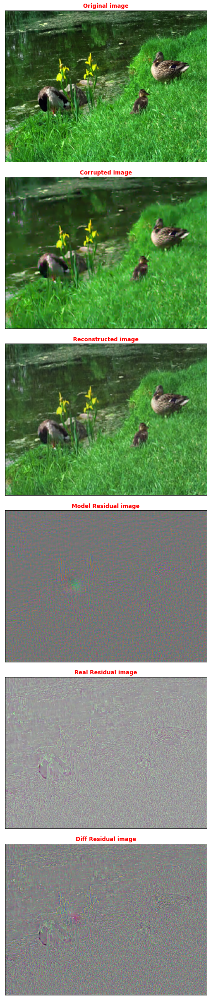

Saving checkpoint...
'/content/checkpoint/checkpoint_nuclass2_44.pth' -> '/content/drive/MyDrive/Models/Checkpoints/MyVideoModel_Final_Residual_V3_BN_Diff/checkpoint_nuclass2_44.pth'
'/content/Loss_History/NU_Class_Net2_Loss_44.json' -> '/content/drive/MyDrive/Models/Checkpoints/MyVideoModel_Final_Residual_V3_BN_Diff/NU_Class_Net2_Loss_44.json'
EPOCH 45/144


  0%|          | 0/2588 [00:00<?, ?it/s]

  0%|          | 0/394 [00:00<?, ?it/s]


 EPOCH 45/101 	 Residual train loss 0.01942192 	 Residual val loss 0.023168701679
Saving checkpoint...
'/content/checkpoint/checkpoint_nuclass2_45.pth' -> '/content/drive/MyDrive/Models/Checkpoints/MyVideoModel_Final_Residual_V3_BN_Diff/checkpoint_nuclass2_45.pth'
'/content/Loss_History/NU_Class_Net2_Loss_45.json' -> '/content/drive/MyDrive/Models/Checkpoints/MyVideoModel_Final_Residual_V3_BN_Diff/NU_Class_Net2_Loss_45.json'
EPOCH 46/144


  0%|          | 0/2588 [00:00<?, ?it/s]

  0%|          | 0/394 [00:00<?, ?it/s]


 EPOCH 46/101 	 Residual train loss 0.01941580 	 Residual val loss 0.023178981617


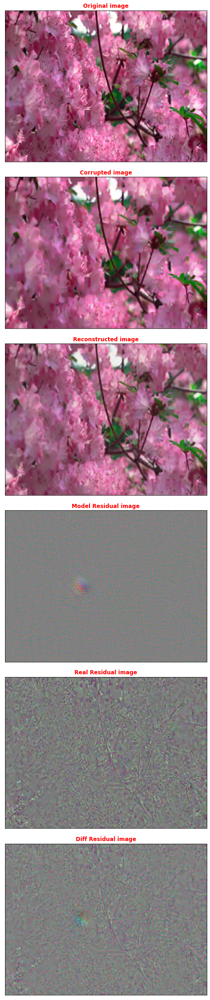

Saving checkpoint...
'/content/checkpoint/checkpoint_nuclass2_46.pth' -> '/content/drive/MyDrive/Models/Checkpoints/MyVideoModel_Final_Residual_V3_BN_Diff/checkpoint_nuclass2_46.pth'
'/content/Loss_History/NU_Class_Net2_Loss_46.json' -> '/content/drive/MyDrive/Models/Checkpoints/MyVideoModel_Final_Residual_V3_BN_Diff/NU_Class_Net2_Loss_46.json'
EPOCH 47/144


  0%|          | 0/2588 [00:00<?, ?it/s]

  0%|          | 0/394 [00:00<?, ?it/s]


 EPOCH 47/101 	 Residual train loss 0.01940308 	 Residual val loss 0.023186095059
Saving checkpoint...
'/content/checkpoint/checkpoint_nuclass2_47.pth' -> '/content/drive/MyDrive/Models/Checkpoints/MyVideoModel_Final_Residual_V3_BN_Diff/checkpoint_nuclass2_47.pth'
'/content/Loss_History/NU_Class_Net2_Loss_47.json' -> '/content/drive/MyDrive/Models/Checkpoints/MyVideoModel_Final_Residual_V3_BN_Diff/NU_Class_Net2_Loss_47.json'
EPOCH 48/144


  0%|          | 0/2588 [00:00<?, ?it/s]

  0%|          | 0/394 [00:00<?, ?it/s]


 EPOCH 48/101 	 Residual train loss 0.01944289 	 Residual val loss 0.023238733411


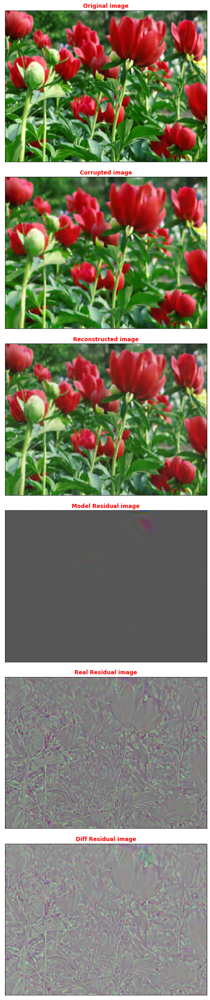

Saving checkpoint...
'/content/checkpoint/checkpoint_nuclass2_48.pth' -> '/content/drive/MyDrive/Models/Checkpoints/MyVideoModel_Final_Residual_V3_BN_Diff/checkpoint_nuclass2_48.pth'
'/content/Loss_History/NU_Class_Net2_Loss_48.json' -> '/content/drive/MyDrive/Models/Checkpoints/MyVideoModel_Final_Residual_V3_BN_Diff/NU_Class_Net2_Loss_48.json'
EPOCH 49/144


  0%|          | 0/2588 [00:00<?, ?it/s]

  0%|          | 0/394 [00:00<?, ?it/s]


 EPOCH 49/101 	 Residual train loss 0.01939119 	 Residual val loss 0.023153007030
Saving checkpoint...
'/content/checkpoint/checkpoint_nuclass2_49.pth' -> '/content/drive/MyDrive/Models/Checkpoints/MyVideoModel_Final_Residual_V3_BN_Diff/checkpoint_nuclass2_49.pth'
'/content/Loss_History/NU_Class_Net2_Loss_49.json' -> '/content/drive/MyDrive/Models/Checkpoints/MyVideoModel_Final_Residual_V3_BN_Diff/NU_Class_Net2_Loss_49.json'
EPOCH 50/144


  0%|          | 0/2588 [00:00<?, ?it/s]

  0%|          | 0/394 [00:00<?, ?it/s]


 EPOCH 50/101 	 Residual train loss 0.01936223 	 Residual val loss 0.023199252784


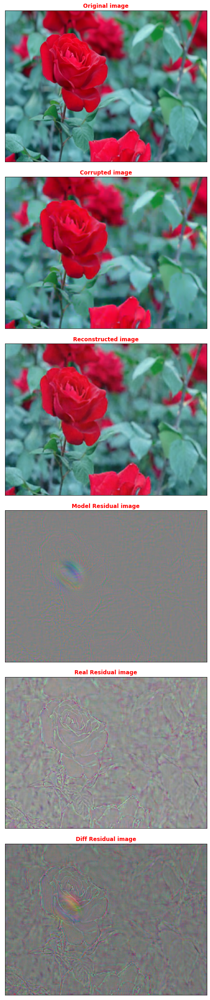

Saving checkpoint...
'/content/checkpoint/checkpoint_nuclass2_50.pth' -> '/content/drive/MyDrive/Models/Checkpoints/MyVideoModel_Final_Residual_V3_BN_Diff/checkpoint_nuclass2_50.pth'
'/content/Loss_History/NU_Class_Net2_Loss_50.json' -> '/content/drive/MyDrive/Models/Checkpoints/MyVideoModel_Final_Residual_V3_BN_Diff/NU_Class_Net2_Loss_50.json'
EPOCH 51/144


  0%|          | 0/2588 [00:00<?, ?it/s]

  0%|          | 0/394 [00:00<?, ?it/s]


 EPOCH 51/101 	 Residual train loss 0.01935769 	 Residual val loss 0.023150000721
Saving checkpoint...
'/content/checkpoint/checkpoint_nuclass2_51.pth' -> '/content/drive/MyDrive/Models/Checkpoints/MyVideoModel_Final_Residual_V3_BN_Diff/checkpoint_nuclass2_51.pth'
'/content/Loss_History/NU_Class_Net2_Loss_51.json' -> '/content/drive/MyDrive/Models/Checkpoints/MyVideoModel_Final_Residual_V3_BN_Diff/NU_Class_Net2_Loss_51.json'
EPOCH 52/144


  0%|          | 0/2588 [00:00<?, ?it/s]

  0%|          | 0/394 [00:00<?, ?it/s]


 EPOCH 52/101 	 Residual train loss 0.01934585 	 Residual val loss 0.023109145463


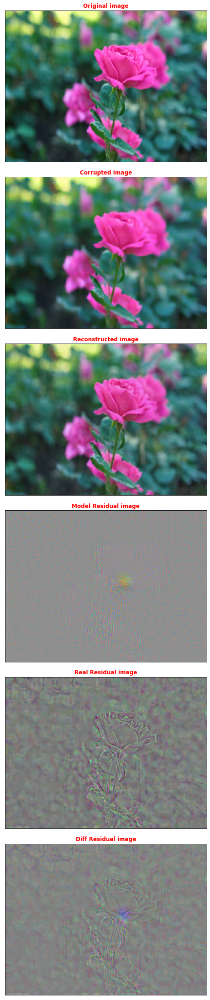

Saving checkpoint...
'/content/checkpoint/checkpoint_nuclass2_52.pth' -> '/content/drive/MyDrive/Models/Checkpoints/MyVideoModel_Final_Residual_V3_BN_Diff/checkpoint_nuclass2_52.pth'
'/content/Loss_History/NU_Class_Net2_Loss_52.json' -> '/content/drive/MyDrive/Models/Checkpoints/MyVideoModel_Final_Residual_V3_BN_Diff/NU_Class_Net2_Loss_52.json'
EPOCH 53/144


  0%|          | 0/2588 [00:00<?, ?it/s]

  0%|          | 0/394 [00:00<?, ?it/s]


 EPOCH 53/101 	 Residual train loss 0.01934597 	 Residual val loss 0.023107472807
Saving checkpoint...
'/content/checkpoint/checkpoint_nuclass2_53.pth' -> '/content/drive/MyDrive/Models/Checkpoints/MyVideoModel_Final_Residual_V3_BN_Diff/checkpoint_nuclass2_53.pth'
'/content/Loss_History/NU_Class_Net2_Loss_53.json' -> '/content/drive/MyDrive/Models/Checkpoints/MyVideoModel_Final_Residual_V3_BN_Diff/NU_Class_Net2_Loss_53.json'
EPOCH 54/144


  0%|          | 0/2588 [00:00<?, ?it/s]

  0%|          | 0/394 [00:00<?, ?it/s]


 EPOCH 54/101 	 Residual train loss 0.01933951 	 Residual val loss 0.023122286424


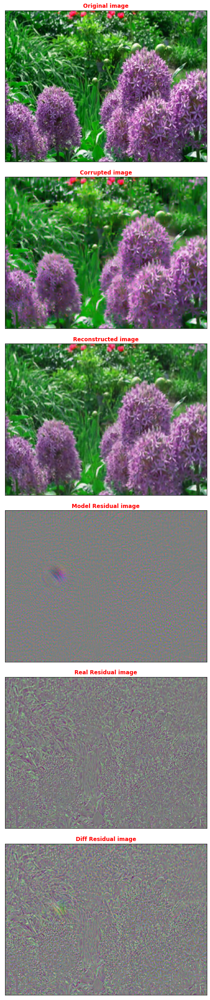

Saving checkpoint...
'/content/checkpoint/checkpoint_nuclass2_54.pth' -> '/content/drive/MyDrive/Models/Checkpoints/MyVideoModel_Final_Residual_V3_BN_Diff/checkpoint_nuclass2_54.pth'
'/content/Loss_History/NU_Class_Net2_Loss_54.json' -> '/content/drive/MyDrive/Models/Checkpoints/MyVideoModel_Final_Residual_V3_BN_Diff/NU_Class_Net2_Loss_54.json'
EPOCH 55/144


  0%|          | 0/2588 [00:00<?, ?it/s]

In [ ]:
### Training cycle

for epoch in range(start_epoch, start_epoch + num_epochs):
    print('EPOCH %d/%d' % (epoch, start_epoch + num_epochs))
    ### Training (use the training function)
    res_train_loss = train_epoch_den2(
        my_model1=nu_class_net1,
        my_model2=nu_class_net2,
        epoch=epoch
    )
    ### Validation  (use the testing function)
    res_val_loss = test_epoch_den2(
        my_model1=nu_class_net1,
        my_model2=nu_class_net2,
        epoch=epoch
    )
    # Print Validationloss
    # history_da['train_loss'].append(float(train_loss))
    # history_da['valid_loss'].append(float(val_loss))
    history_da['res_train_loss'].append(float(res_train_loss))
    history_da['res_valid_loss'].append(float(res_val_loss))
    print('\n EPOCH {}/{} \t Residual train loss {:.8f} \t Residual val loss {:.12f}'.format(epoch, num_epochs, res_train_loss, res_val_loss))

    if (epoch % 2) == 0:
        plot_ae_outputs_den2(my_model1=nu_class_net1, my_model2=nu_class_net2, my_loader=test_loader, device=device)
    my_nu_class_checkpoint2.save(model=nu_class_net2, epoch=epoch, res_train_loss=res_train_loss, res_val_loss=res_val_loss, train_loss=0, val_loss=0)
    nu_class_net_loss_hsitory2.save(loss_history=history_da, start_epoch=start_epoch, num_epochs=num_epochs, epoch=epoch)


In [ ]:
my_nu_class_checkpoint2.save(model=nu_class_net2, epoch=0, res_train_loss=res_train_loss, res_val_loss=res_val_loss, train_loss=0, val_loss=0)
nu_class_net_loss_hsitory2.save(loss_history=history_da, start_epoch=start_epoch, num_epochs=num_epochs, epoch=0)

In [ ]:
fig = plt.figure(figsize=(10, 7));
# plt.plot(history_da['res_train_loss'][0:24], label='Res-Train loss')
valid_losses = history_da['res_valid_loss'][:24]
train_losses = history_da['res_train_loss'][:24]
initialize_loss1 = 0.036506280303001404
initialize_loss2 = 0.036506280303001404
valid_losses.insert(0, initialize_loss1)
train_losses.insert(0, initialize_loss2)
plt.plot(train_losses, label='Res-Train loss')
plt.plot(valid_losses, label='Res-Validation loss')
plt.axhline(y=0.0, label='Zero Test Loss', c='red')

plt.xlabel("Iteration")
plt.ylabel("Residual Loss")
plt.title("Calculated Res-Losses for ADE", fontsize=15)
plt.legend();
plt.show();

# **Reconstructing Video:**

In [ ]:
from torchvision.utils import save_image

In [ ]:
!mkdir '/content/Frames/ReConstructedFrames/'
!mkdir '/content/Frames/ReConstructedFrames/Train/'
!mkdir '/content/Frames/ReConstructedFrames/Test/'

In [ ]:
save_path_test = '/content/Frames/ReConstructedFrames/Test/'
save_path_train = '/content/Frames/ReConstructedFrames/Train/'

train_loader_1 = torch.utils.data.DataLoader(train_dataset, batch_size=1, shuffle=False)
test_loader_1 = torch.utils.data.DataLoader(test_dataset, batch_size=1, shuffle=False)

In [ ]:
### Training function
def make_model_train_frames():
    # Set train mode for both the encoder and the decoder
    u_net.eval()

    with torch.no_grad(): # No need to track the gradients
        # Iterate the dataloader (we do not need the label values, this is unsupervised learning)
        for iter, (batch) in enumerate(tqdm(train_loader_1)): # with "_" we just ignore the labels (the second element of the dataloader tuple)
            file_name_number = batch['CompName'][0][9:14]
            file_name = "recframe" + str(file_name_number) + ".png"
            # Move tensor to the proper device
            noisy_batch = batch['CompIMG'].to(device)
            # U-Net data
            decoded_data = u_net(noisy_batch)
            # Evaluate loss
            rec_image = decoded_data + noisy_batch
            save_image((rec_image.view(3, 240, 320)), str(save_path_train + file_name))


### Testing function
def make_model_test_frames():
    # Set evaluation mode for encoder and decoder
    u_net.eval()

    with torch.no_grad(): # No need to track the gradients
        # Define the lists to store the outputs for each batch
        # with tqdm(test_loader, unit="batch") as tepoch:
        for iter, (batch) in enumerate(tqdm(test_loader_1)): #zip(tqdm(test_decoded_loader), test_raw_loader):
            file_name_number = batch['CompName'][0][9:14]
            file_name = "recframe" + str(file_name_number) + ".png"
            # Move tensor to the proper device
            noisy_batch = batch['CompIMG'].to(device)
            # U-Net data
            decoded_data = u_net(noisy_batch)
            # Evaluate loss
            rec_image = decoded_data + noisy_batch
            save_image((rec_image.view(3, 240, 320)), str(save_path_test + file_name))


In [ ]:
make_model_train_frames()
make_model_test_frames()

In [ ]:
!zip -r "./ReConstructedFrames_240p_6Frames_CRF40_13_PNG_RGB_Slow.zip" "./Frames/ReConstructedFrames"

In [ ]:
!cp -av './ReConstructedFrames_240p_6Frames_CRF40_13_PNG_RGB_Slow.zip' '/content/drive/Shareddrives/AI/Datasets/ExtractedFrames/Nature_Frames2/'

In [ ]:
# img_noise = iter(noise_dataloader).next()
# img = iter(dataloader_train).next()


# # import matplotlib.pyplot as plt
# # a = np.array([1,2,3,4,5])
# # a = np.expand_dims(a, axis=0)  # or axis=1
# # plt.imshow(a)
# # plt.show()
# # with torch.no_grad():
# #     rec_img_noise  = decoder(encoder(img_noise[0]))



# import numpy as np

# def valid_imshow_data(data):
#     data = np.asarray(data)
#     if data.ndim == 2:
#         return True
#     elif data.ndim == 3:
#         if 3 <= data.shape[2] <= 4:
#             return True
#         else:
#             print('The "data" has 3 dimensions but the last dimension '
#                   'must have a length of 3 (RGB) or 4 (RGBA), not "{}".'
#                   ''.format(data.shape[2]))
#             return False
#     else:
#         print('To visualize an image the data must be 2 dimensional or '
#               '3 dimensional, not "{}".'
#               ''.format(data.ndim))
#         return False

# print(img_noise[0][0].shape)
# a = valid_imshow_data(img_noise[0][0])


# #     rec_img  = img[0]))
# plt.imshow(torch.squeeze(img_noise[0][0]).reshape(288, 352, 3))
# # rec_img_noise(img[0])

In [ ]:
# my_loss = nn.MSELoss()

# no_dae_loss = []
# for (noise_batch, _), (image_batch, _) in zip(train_decoded_loader, train_raw_loader):
#     # Move tensor to the proper device
#     # image_noisy = add_noise(image_batch,noise_factor)
#     # image_noisy = noise_batch.to(device)
#     # Encode data
#     # encoded_data = encoder(image_noisy)
#     # Decode data
#     # decoded_data = decoder(encoded_data)
#     # Append the network output and the original image to the lists
#     # conc_out.append(decoded_data.cpu())
#     # conc_label.append(image_batch.cpu())
#     loss = my_loss(noise_batch.cpu(), image_batch.cpu())
#     no_dae_loss.append(loss.detach().cpu().numpy())

# print("Train Loss without DAE:=> ", np.mean(no_dae_loss))

In [ ]:
# my_loss = nn.MSELoss()

# no_dae_loss = []
# for (noise_batch, _), (image_batch, _) in zip(test_decoded_loader, test_raw_loader):
#     # Move tensor to the proper device
#     # image_noisy = add_noise(image_batch,noise_factor)
#     # image_noisy = noise_batch.to(device)
#     # Encode data
#     # encoded_data = encoder(image_noisy)
#     # Decode data
#     # decoded_data = decoder(encoded_data)
#     # Append the network output and the original image to the lists
#     # conc_out.append(decoded_data.cpu())
#     # conc_label.append(image_batch.cpu())
#     loss = my_loss(noise_batch.cpu(), image_batch.cpu())
#     no_dae_loss.append(loss.detach().cpu().numpy())

# print("Test Loss without DAE:=> {:.12f}".format(np.mean(no_dae_loss)))

In [ ]:
batch1_decoded, batch_raw = next(iter(train_loader))

plt.imshow(batch1_decoded[7].view(3, 256, 512).permute(1, 2, 0).detach().cpu().numpy())

In [ ]:

plt.imshow(batch1_decoded[7].view(3, 256, 512).permute(1, 2, 0).detach().cpu().numpy())

In [ ]:
torch.cuda.empty_cache()
del encoded_data
del decoded_data
del test_loader

In [ ]:
encoded_data = u_net(batch1_decoded[7].view(1, 3, 256, 512).to(device))
# Decode data
# decoded_data = decoder(encoded_data)

In [ ]:
print(decoded_data)

In [ ]:
reconstructed_img = batch1_decoded[7].detach().cpu() + decoded_data.detach().cpu()
plt.imshow(reconstructed_img.view(3, 256, 512).permute(1, 2, 0).numpy())

In [ ]:
from torchvision.utils import save_image
save_image(batch1_decoded[7], "noisy.bmp")


In [ ]:
save_image(reconstructed_img, "reconstructed_img.bmp")

In [ ]:

save_image(batch_raw[7], "raw_img.bmp")

In [ ]:
import cv2
# img       = 255 - cv2.resize(batch1_decoded[7],       (0,0), fx = 1/scale_w, fy = 1/scale_h)
# cv2.imwrite(os.path.join('/content', 'img', 'noisy', '{}.jpg'.format(str(1).zfill(6))), img)

In [ ]:
class ImageFolderNew(ImageFolder):
    def _find_classes(self, dir):
        """
        Finds the class folders in a dataset.

        Args:
            dir (string): Root directory path.

        Returns:
            tuple: (classes, class_to_idx) where classes are relative to (dir), and class_to_idx is a dictionary.

        Ensures:
            No class is a subdirectory of another.
        """
        if sys.version_info >= (3, 5):
            # Faster and available in Python 3.5 and above
            classes = [d.name for d in os.scandir(dir) if d.is_dir()]
        else:
            classes = [d for d in os.listdir(dir) if os.path.isdir(os.path.join(dir, d))]
        classes.sort(key=int)
        class_to_idx = {classes[i]: i for i in range(len(classes))}
        return classes, class_to_idx


class MyDataset(Dataset):
    def __init__(self, datasetA_dir, datasetB_dir, transform=None):
        self.datasetA_dir = datasetA_dir
        self.datasetB_dir = datasetB_dir
        self.transform = transform
        
    def __getitem__(self, index):
        # print("index: ", index)
        # print("dirA: ", self.datasetA_dir)
        # print("dirB: ", self.datasetB_dir)
        # print("LenA: ", len(self.datasetA_dir))
        # print("LenB: ", len(self.datasetB_dir))
        digA = "compframe00315"  + ".png"
        dirA = os.path.join(self.datasetA_dir, digA)
        digB = "rawframe00315" + ".png"
        dirB = os.path.join(self.datasetB_dir, digB)
        # xA = self.datasetA_dir[index]
        # xB = self.datasetB_dir[index]
        imageA = io.imread(dirA)
        imageB = io.imread(dirB)
        if self.transform:
            imageA = self.transform(imageA)
            imageB = self.transform(imageB)
        return imageA, imageB
    
    def __len__(self):
        path, dirs, filesA = next(os.walk(self.datasetA_dir))
        # path, dirs, filesB = next(os.walk(self.datasetB_dir))
        file_countA = len(filesA)
        # file_countB = len(filesB)
        # print("File CountA: ", file_countA)
        # print("File CountB: ", file_countB)
        # print("Len Decoded:", len(self.datasetA_dir))
        # print("Len Raw:", len(self.datasetB_dir))
        return file_countA

In [ ]:
test_dataset2 = MyDataset('/content/Frame2/dec/', '/content/Frame2/raw/', transform=transforms.Compose([
                                transforms.ToTensor(),
                                torchvision.transforms.Normalize(
                                  mean=[0.5, 0.5, 0.5],
                                  std=[0.5, 0.5, 0.5],
                              ),
                            ])
)


In [ ]:
test_loader2 = torch.utils.data.DataLoader(test_dataset2, batch_size=1, shuffle=True)

In [ ]:
image_noisy, org_img = next(iter(test_loader2))

image_noisy = image_noisy.to(device)
residual_img = u_net(image_noisy.view(1, 3, 360, 640))

# res = u_net(test_loader2)

reconstructed_img = image_noisy.detach().cpu() + residual_img.detach().cpu()